# Joseph Sabaybay

### Import all of the libraries that I think I will need

Selenium, Beautiful Soup, Pandas, NumPy, Time, Datetime, Random, tqdm and Matplot

In [1]:
import datetime as dt
import pandas as pd
import numpy as np
import random 
import requests

from bs4 import BeautifulSoup
from time import sleep as sl
from tqdm import tqdm

import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
from selenium import webdriver
from selenium.webdriver.common.keys import Keys
from selenium.webdriver.common.by import By
from selenium.webdriver.support.ui import WebDriverWait
from selenium.webdriver.support import expected_conditions as EC

driver = webdriver.Chrome('chromedriver.exe')

driver.get("https://www.tripadvisor.ca/") # takes me to the home page of tripadvisor

C:\Users\Home\AppData\Local\Temp\ipykernel_6448\254848931.py:7: DeprecationWarning: executable_path has been deprecated, please pass in a Service object
  driver = webdriver.Chrome('chromedriver.exe')


# Set up

get to the attractions page for Vancouver

In [3]:
driver.find_element(By.CSS_SELECTOR, '#lithium-root > main > div.QvCXh.cyIij.fluiI > div > div > div.slvrn.Z0.Wh.EcFTp > form > input.qjfqs._G.B-.z._J.Cj.R0').click()

In [4]:
# selects the search bar so i can input Vancouver on the next cell
search_bar = driver.find_element(By.CSS_SELECTOR, '#lithium-root > main > div.QvCXh.cyIij.fluiI > div > div > div.slvrn.Z0.Wh.rsqqi.EcFTp > form > input.qjfqs._G.B-.z._J.Cj.R0')

In [5]:
search_bar.send_keys('Vancouver Things To Do')

In [6]:
search_bar.send_keys(Keys.RETURN)

In [7]:
driver.find_element(By.CSS_SELECTOR, '#lithium-root > main > span > div > div.Igubo.z.RQllt > div > div:nth-child(2) > div.IyYBN._T > span > div > div:nth-child(2) > section:nth-child(4) > div > div > span > div > div.qwTDE > div > a').click()

In [8]:
driver.switch_to.window(driver.window_handles[1]) # switches to the next tab

In [9]:
driver.execute_script("window.scrollTo(0, 9600)") # scrolls down to the bottom of the page

# 1.0 Build the code piece by piece to see if they work

### For final webscraping code go to 1.5

## 1.1 Scraping one page to see if can grab the attraction links

In [10]:
page_source = driver.page_source

In [11]:
soup = BeautifulSoup(page_source, 'lxml')

In [12]:
type(soup)

bs4.BeautifulSoup

In [13]:
soup.find_all('div', class_ = 'alPVI eNNhq PgLKC tnGGX')

[<div class="alPVI eNNhq PgLKC tnGGX"><a href="/Attraction_Review-g154943-d155652-Reviews-Stanley_Park-Vancouver_British_Columbia.html" target="_blank"><h3 class="biGQs _P fiohW ngXxk"><div class="ATCbm"><span name="title"><div class="XfVdV o AIbhI"><span class="vAUKO">1.</span> <!-- -->Stanley Park</div></span></div></h3></a><a class="BMQDV _F G- wSSLS SwZTJ FGwzt ukgoS" href="/Attraction_Review-g154943-d155652-Reviews-Stanley_Park-Vancouver_British_Columbia.html#REVIEWS" tabindex="0" target="_blank"><div class="jVDab o W f u w JqMhy"><svg aria-label="4.5 of 5 bubbles" class="UctUV d H0" height="12" viewbox="0 0 128 24" width="68"><path d="M 12 0C5.388 0 0 5.388 0 12s5.388 12 12 12 12-5.38 12-12c0-6.612-5.38-12-12-12z" transform=""></path><path d="M 12 0C5.388 0 0 5.388 0 12s5.388 12 12 12 12-5.38 12-12c0-6.612-5.38-12-12-12z" transform="translate(26 0)"></path><path d="M 12 0C5.388 0 0 5.388 0 12s5.388 12 12 12 12-5.38 12-12c0-6.612-5.38-12-12-12z" transform="translate(52 0)"></path>

In [14]:
for div in soup.find_all('div', class_ = 'alPVI eNNhq PgLKC tnGGX'):
    a = div.find('a').get('href')
    print(a)

/Attraction_Review-g154943-d155652-Reviews-Stanley_Park-Vancouver_British_Columbia.html
/Attraction_Review-g154943-d156255-Reviews-Granville_Island-Vancouver_British_Columbia.html
/Attraction_Review-g154943-d155848-Reviews-Vancouver_Aquarium-Vancouver_British_Columbia.html
/Attraction_Review-g154943-d156254-Reviews-Queen_Elizabeth_Park-Vancouver_British_Columbia.html
/Attraction_Review-g154943-d184433-Reviews-VanDusen_Botanical_Garden-Vancouver_British_Columbia.html
/Attraction_Review-g154943-d282447-Reviews-Granville_Island_Public_Market-Vancouver_British_Columbia.html
/Attraction_Review-g154943-d155906-Reviews-Museum_of_Anthropology-Vancouver_British_Columbia.html
/Attraction_Review-g154943-d3858597-Reviews-Vancouver_Seawall-Vancouver_British_Columbia.html
/Attraction_Review-g154943-d4442628-Reviews-FlyOver_Canada-Vancouver_British_Columbia.html
/Attraction_Review-g154943-d501708-Reviews-Vancouver_Downtown-Vancouver_British_Columbia.html
/Attraction_Review-g154943-d185017-Reviews-Van

#### This took a while to figure out, I kept getting stuck on this loop as it only took 12 links instead of all 30 links in one page ^^^
    - the solution was I needed to switch tabs on the browser and scroll to the bottom of the page to access all the links

## 1.2 Now  testing a loop to get to the next page

In [131]:
# Base code where click on next page then scroll down
driver.execute_script("window.scrollTo(0, 9600)")
driver.find_element(By.CSS_SELECTOR, '[aria-label="Next page"]').click()

#### The python code is running too fast and giving me an error of "ElementClickInterceptedException"
- one solution i found on the internet is that the code is being executed quickly and missing the next page button so I have to implement a timer

In [159]:
# Shows how many results in each page
results = driver.find_element(By.CLASS_NAME, 'Ci').text.split()[2]

In [37]:
# Managed to get to the last page with no issue for now
# this is a different loop than the one below i was thinking of something much more complicated and will use it maybe next time
while True:
    try:
        sl(5)
        driver.execute_script("window.scrollTo(0, 9600)")
        
        element = WebDriverWait(driver, 15).until(
            EC.presence_of_element_located((By.CSS_SELECTOR, '[aria-label="Next page"]')))
        element.click()
    except:
        break

## 1.3 Get all links till the last page

In [15]:
def scroll_dwn():
    scroll_dwn = driver.execute_script("window.scrollTo(0, 11000)")
    return scroll_dwn

In [16]:
links = []
for div in soup.find_all('div', class_ = 'alPVI eNNhq PgLKC tnGGX'):
    a = div.find('a').get('href')
    new_a = 'https://tripadvisor.ca' + a
    links.append(new_a)
    
links

['https://tripadvisor.ca/Attraction_Review-g154943-d155652-Reviews-Stanley_Park-Vancouver_British_Columbia.html',
 'https://tripadvisor.ca/Attraction_Review-g154943-d156255-Reviews-Granville_Island-Vancouver_British_Columbia.html',
 'https://tripadvisor.ca/Attraction_Review-g154943-d155848-Reviews-Vancouver_Aquarium-Vancouver_British_Columbia.html',
 'https://tripadvisor.ca/Attraction_Review-g154943-d156254-Reviews-Queen_Elizabeth_Park-Vancouver_British_Columbia.html',
 'https://tripadvisor.ca/Attraction_Review-g154943-d184433-Reviews-VanDusen_Botanical_Garden-Vancouver_British_Columbia.html',
 'https://tripadvisor.ca/Attraction_Review-g154943-d282447-Reviews-Granville_Island_Public_Market-Vancouver_British_Columbia.html',
 'https://tripadvisor.ca/Attraction_Review-g154943-d155906-Reviews-Museum_of_Anthropology-Vancouver_British_Columbia.html',
 'https://tripadvisor.ca/Attraction_Review-g154943-d3858597-Reviews-Vancouver_Seawall-Vancouver_British_Columbia.html',
 'https://tripadvisor.c

In [17]:
links[0]

'https://tripadvisor.ca/Attraction_Review-g154943-d155652-Reviews-Stanley_Park-Vancouver_British_Columbia.html'

In [18]:
driver.get(links[0])

In [18]:
def get_page(num):
    url = f'https://www.tripadvisor.ca/Attractions-g154943-Activities-oa{num}-Vancouver_British_Columbia.html'
    driver.get(url)
    return driver.page_source

In [19]:
# grabs all the links from all the pages
num = 0
links = [] # appends it to this list
for _ in range(46):
    get_page(num)
    sl(2) # had to manipulate the order of the sleep function. It skipped the first 2 pages and here is the postion where it worked
    soup = driver.page_source
    soup = BeautifulSoup(soup, 'lxml')
    print(soup)
    sl(2)
    scroll_dwn()
    for div in soup.find_all('div', class_ = 'alPVI eNNhq PgLKC tnGGX'):
        a = div.find('a').get('href')
        new_a = 'https://tripadvisor.ca' + a
        links.append(new_a)
    #print(a)
    num += 30  # the url changes by 30 when going to the next page

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa0-Van

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa30-Va

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa60-Va

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa90-Va

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa120-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa150-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa180-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa210-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa240-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa270-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa300-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa330-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa360-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa390-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa420-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa450-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa480-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa510-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa540-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa570-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa600-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa630-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa660-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa690-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa720-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa750-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa780-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa810-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa840-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa870-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa900-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa930-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa960-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa990-V

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa1020-

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa1050-

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa1080-

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa1110-

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa1140-

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa1170-

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa1200-

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa1230-

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa1260-

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa1290-

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa1320-

<html lang="en-CA"><head><meta content="text/html; charset=utf-8" http-equiv="content-type"/><meta content="en" http-equiv="content-language"/><link as="font" crossorigin="anonymous" href="https://static.tacdn.com/css2/webfonts/TripSans/TripSans-VF.woff2?v1.002" rel="preload" type="font/woff2"/><link href="https://static.tacdn.com/favicon.ico?v2" id="favicon" rel="icon" type="image/x-icon"/><link color="#000000" href="https://static.tacdn.com/img2/brand_refresh/application_icons/mask-icon.svg" rel="mask-icon" sizes="any"/><meta content="#34e0a1" name="theme-color"/><meta content="telephone=no" name="format-detection"/><meta content="TripAdvisor" property="al:ios:app_name"/><meta content="284876795" property="al:ios:app_store_id"/><meta content="284876795" name="twitter:app:id:ipad" property="twitter:app:id:ipad"/><meta content="284876795" name="twitter:app:id:iphone" property="twitter:app:id:iphone"/><meta content="tripadvisor://www.tripadvisor.ca/Attractions-g154943-Activities-oa1350-

In [20]:
len(links)

1376

#### ^^^ updated list need to refresh page source so i  can loop all the links

#### had trouble with getting all the links as it skips a few pages. since im manipulating between BeautifulSoup and Selenium
#### i had to play around being online and offline the webpage. Also i had to keep getting the page source so i can grab the attributes

## 1.4 get all the attriubutes of the page

In [180]:
# title
soup.find('h1', class_ = 'biGQs _P fiohW eIegw').get_text()

'Celebration of Light'

In [259]:
# Address
soup.find_all('button', class_ = 'UikNM _G B- _S _T c G_ P0 wSSLS wnNQG raEkE')[-1].get_text()

'1100 Chestnut St at Vanier Park, Vancouver, British Columbia V6J 3J9 Canada'

In [194]:
# Category
soup.find('div', class_ = 'fIrGe _T bgMZj').get_text()

'Seasonal Fireworks'

In [207]:
# Rating
soup.find('div', class_ = 'biGQs _P fiohW hzzSG uuBRH').get_text()

'4.5'

In [209]:
# Number of Reviews
soup.find('span', class_ = 'biGQs _P pZUbB biKBZ KxBGd').get_text()

'54'

In [277]:
#Suggested_duration
soup.find('div', class_ = '_c').get_text().split(' ')[0].split('-')[1]

'2'

## 1.5 Grabbing all the data

In [21]:
test = []
driver.get(links[0]) # gets to the link
soup = driver.page_source
soup = BeautifulSoup(soup, 'lxml')
scroll_dwn()
sl(2)
# get all attributes on your page
for _ in links[0]:
    try:
        t = soup.find('h1', class_ = 'biGQs _P fiohW eIegw').get_text()
        test.append(t)
    except:
        test.append('N/a')
    
    try:
        a = soup.find_all('button', class_ = 'UikNM _G B- _S _T c G_ P0 wSSLS wnNQG raEkE')[-1].get_text()
        test.append(a)
    except:
        test.append('N/a')
        
    try:
        c = soup.find('div', class_ = 'fIrGe _T bgMZj').get_text()
        test.append(c)
    except:
        test.append('N/a')
        
    try:
        r = soup.find('div', class_ = 'biGQs _P fiohW hzzSG uuBRH').get_text()
        test.append(r)
    except:
        test.append('N/a')
        
    try:
        num_review = soup.find('span', class_ = 'biGQs _P pZUbB biKBZ KxBGd').get_text()
        test.append(num_review)
    except:
        test.append('N/a')
    
    try: 
        suggested_duration = soup.find('div', class_ = '_c').get_text().split(' ')[0].split('-')[1]
        test.append(suggested_duration)
    except:
        test.append('N/a')
        

In [22]:
test

['Stanley Park',
 'Stanley Park Causeway, Vancouver, British Columbia V6G 1Z4 Canada',
 'Parks',
 '4.5',
 '29,062',
 '3',
 'Stanley Park',
 'Stanley Park Causeway, Vancouver, British Columbia V6G 1Z4 Canada',
 'Parks',
 '4.5',
 '29,062',
 '3',
 'Stanley Park',
 'Stanley Park Causeway, Vancouver, British Columbia V6G 1Z4 Canada',
 'Parks',
 '4.5',
 '29,062',
 '3',
 'Stanley Park',
 'Stanley Park Causeway, Vancouver, British Columbia V6G 1Z4 Canada',
 'Parks',
 '4.5',
 '29,062',
 '3',
 'Stanley Park',
 'Stanley Park Causeway, Vancouver, British Columbia V6G 1Z4 Canada',
 'Parks',
 '4.5',
 '29,062',
 '3',
 'Stanley Park',
 'Stanley Park Causeway, Vancouver, British Columbia V6G 1Z4 Canada',
 'Parks',
 '4.5',
 '29,062',
 '3',
 'Stanley Park',
 'Stanley Park Causeway, Vancouver, British Columbia V6G 1Z4 Canada',
 'Parks',
 '4.5',
 '29,062',
 '3',
 'Stanley Park',
 'Stanley Park Causeway, Vancouver, British Columbia V6G 1Z4 Canada',
 'Parks',
 '4.5',
 '29,062',
 '3',
 'Stanley Park',
 'Stanl

In [21]:
data = []
# once i get all the links 
for link in links:
    driver.get(link) # gets to the link
    sl(3) # pause for 3 seconds before scrolling down 
    soup = driver.page_source
    soup = BeautifulSoup(soup, 'lxml') # updates the page source every single current page
    scroll_dwn()
    sl(2)
    # get all attributes on your page
    try:
        t = soup.find('h1', class_ = 'biGQs _P fiohW eIegw').get_text()
        data.append(t)
    except:
        data.append('N/a')
    
    try:
        a = soup.find_all('button', class_ = 'UikNM _G B- _S _T c G_ P0 wSSLS wnNQG raEkE')[-1].get_text()
        data.append(a)
    except:
        data.append('N/a')
        
    try:
        c = soup.find('div', class_ = 'fIrGe _T bgMZj').get_text()
        data.append(c)
    except:
        data.append('N/a')
        
    try:
        r = soup.find('div', class_ = 'biGQs _P fiohW hzzSG uuBRH').get_text()
        data.append(r)
    except:
        data.append('N/a')
        
    try:
        num_review = soup.find('span', class_ = 'biGQs _P pZUbB biKBZ KxBGd').get_text()
        data.append(num_review)
    except:
        data.append('N/a')
    
    try: 
        suggested_duration = soup.find('div', class_ = '_c').get_text().split(' ')[0].split('-')[1]
        data.append(suggested_duration)
    except:
        data.append('N/a')

### Forgot to time it but  it took around 2.5 hrs to complete

In [22]:
# with 1376 links and looking for 6 specific attributes i have 8244 results
len(data)

8256

In [23]:
data[:180]

['Stanley Park',
 'Stanley Park Causeway, Vancouver, British Columbia V6G 1Z4 Canada',
 'Parks',
 '4.5',
 '29,062',
 '3',
 'Granville Island',
 'N/a',
 'Neighbourhoods • Points of Interest & Landmarks • Islands',
 '4.5',
 '19,830',
 '2',
 'Vancouver Aquarium',
 '845 Avison Way, Stanley Park, Vancouver, British Columbia V6G 3E2 Canada',
 'Aquariums',
 '4.5',
 '8,522',
 '2',
 'Queen Elizabeth Park',
 '4600 Cambie St, Vancouver, British Columbia V5Y 2M4 Canada',
 'Parks • Gardens',
 '4.5',
 '2,367',
 '2',
 'VanDusen Botanical Garden',
 '5251 Oak St, Vancouver, British Columbia V6M 4H1 Canada',
 'Gardens',
 '4.5',
 '2,077',
 '3',
 'Granville Island Public Market',
 '1689 Johnston St., Vancouver, British Columbia V6H 3S3 Canada',
 'Flea & Street Markets',
 '4.5',
 '1,968',
 'N/a',
 'Museum of Anthropology',
 '6393 North West Marine Dr., Vancouver, British Columbia V6T 1Z2 Canada',
 'Art Galleries • Speciality Museums • Art Museums',
 '4.5',
 '3,820',
 '3',
 'Vancouver Seawall',
 'Stanley Pa

## 2.0 Cleaning up the data

## 2.1 Making a dataframe and converting it into a csv file

In [24]:
# since my data is only one list i need to convert it into a nested list to group the data together
main_data = []

for x in range(0, len(data), 6):
    data[x: x + 6]
    main_data.append(data[x: x + 6])
    x += 6

In [48]:
main_data = [data[x: x + 6] for x in range(0, len(data), 6)]

In [25]:
len(main_data)

1376

In [42]:
df = (pd.DataFrame(main_data, columns = ['attraction_names', 'address', 'category', 'rating', 'num_reviews', 'suggested_duration(hr)']))\
.set_index('attraction_names')

In [41]:
df1 = (pd.DataFrame(main_data, columns = ['attraction_names', 'address', 'category', 'rating', 'num_reviews', 'suggested_duration(hr)']))

In [38]:
df

,attraction_names,address,category,rating,num_reviews,suggested_duration(hr)
0,Stanley Park,"Stanley Park Causeway, Vancouver, British Colu...",Parks,4.5,"29,062",3
1,Granville Island,N/a,Neighbourhoods • Points of Interest & Landmark...,4.5,"19,830",2
2,Vancouver Aquarium,"845 Avison Way, Stanley Park, Vancouver, Briti...",Aquariums,4.5,"8,522",2
3,Queen Elizabeth Park,"4600 Cambie St, Vancouver, British Columbia V5...",Parks • Gardens,4.5,"2,367",2
4,VanDusen Botanical Garden,"5251 Oak St, Vancouver, British Columbia V6M 4...",Gardens,4.5,"2,077",3
...,...,...,...,...,...,...
1371,N/a,N/a,N/a,N/a,N/a,N/a
1372,N/a,N/a,N/a,N/a,N/a,N/a
1373,N/a,N/a,N/a,N/a,N/a,N/a
1374,Sams Original Art,"1736 2nd Ave W, Vancouver, British Columbia V6...",Art Galleries,N/a,N/a,N/a


In [28]:
df.to_csv('tripadvisor_df.csv', index=True)

In [ ]:
df.to_csv('tripadvisor1_df.csv', index=True)

In [39]:
df.to_csv('tripadvisor_df2.csv', index=True)

## 2.2 Taking out the N/a values
- there are some rows that have all N/a values and i am trying to filter out and condense my data
- the website changes its layout when i was scraping so there a full rows that are empty

In [63]:
# since some rows have all N/a values i used drop_duplcaties to clean my data a bit more
new_df = df.drop_duplicates() # attractions as an index

In [91]:
newer_df = df1.drop_duplicates() # no index

In [118]:
newer_df.replace('N/a', np.nan, inplace=True)

C:\Users\Home\AppData\Local\Temp\ipykernel_6448\3604121549.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  newer_df.replace('N/a', np.nan, inplace=True)


In [215]:
newer_df

,attraction_names,address,category,rating,num_reviews,suggested_duration(hr)
0,Stanley Park,"Stanley Park Causeway, Vancouver, British Colu...",Parks,4.5,"29,062",3
1,Granville Island,NaN,Neighbourhoods • Points of Interest & Landmark...,4.5,"19,830",2
2,Vancouver Aquarium,"845 Avison Way, Stanley Park, Vancouver, Briti...",Aquariums,4.5,"8,522",2
3,Queen Elizabeth Park,"4600 Cambie St, Vancouver, British Columbia V5...",Parks • Gardens,4.5,"2,367",2
4,VanDusen Botanical Garden,"5251 Oak St, Vancouver, British Columbia V6M 4...",Gardens,4.5,"2,077",3
...,...,...,...,...,...,...
1355,Taxi2Airport Vancouver,"Weteringschans 28, Vancouver, British Columbia...",Taxis & Shuttles,NaN,NaN,NaN
1359,Heartspace Massage and Healing Arts,"825 Granville St Suite 609, Vancouver, British...",Spas,NaN,NaN,2
1365,"Vancouver Orthotics for Flat Feet, Foot Pain, ...",NaN,Sports Camps & Clinics,NaN,NaN,NaN
1368,A Stylish Arrival,"4155 Beaufort Pl, Vancouver, British Columbia ...",Taxis & Shuttles,NaN,NaN,NaN


# 2.3 Cleaning more data
- the data we scrape has some false values and were trying to convert in into an int or replacing values with 0

In [255]:
# there are still a number of NaN values in attraction names so i dropped the rows
new_df1 = newer_df.dropna(subset=['attraction_names'])

In [256]:
new_df1

,attraction_names,address,category,rating,num_reviews,suggested_duration(hr)
0,Stanley Park,"Stanley Park Causeway, Vancouver, British Colu...",Parks,4.5,"29,062",3
1,Granville Island,NaN,Neighbourhoods • Points of Interest & Landmark...,4.5,"19,830",2
2,Vancouver Aquarium,"845 Avison Way, Stanley Park, Vancouver, Briti...",Aquariums,4.5,"8,522",2
3,Queen Elizabeth Park,"4600 Cambie St, Vancouver, British Columbia V5...",Parks • Gardens,4.5,"2,367",2
4,VanDusen Botanical Garden,"5251 Oak St, Vancouver, British Columbia V6M 4...",Gardens,4.5,"2,077",3
...,...,...,...,...,...,...
1355,Taxi2Airport Vancouver,"Weteringschans 28, Vancouver, British Columbia...",Taxis & Shuttles,NaN,NaN,NaN
1359,Heartspace Massage and Healing Arts,"825 Granville St Suite 609, Vancouver, British...",Spas,NaN,NaN,2
1365,"Vancouver Orthotics for Flat Feet, Foot Pain, ...",NaN,Sports Camps & Clinics,NaN,NaN,NaN
1368,A Stylish Arrival,"4155 Beaufort Pl, Vancouver, British Columbia ...",Taxis & Shuttles,NaN,NaN,NaN


In [257]:
# since there is a comm a i have to split the num_reviews and join them to form one number
new_df1['num_reviews'] = new_df1['num_reviews'].str.split(',').str.join('')

C:\Users\Home\AppData\Local\Temp\ipykernel_6448\4179017224.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df1['num_reviews'] = new_df1['num_reviews'].str.split(',').str.join('')


In [258]:
# there are some attractions that have no reviews so i filled it with 0
new_df1['num_reviews'] = new_df1['num_reviews'].fillna(0)

C:\Users\Home\AppData\Local\Temp\ipykernel_6448\2843928114.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df1['num_reviews'] = new_df1['num_reviews'].fillna(0)


In [259]:
# the data type for num_reviews is still an object so i converted it into an int
new_df1['num_reviews'] = new_df1['num_reviews'].astype('int64')

C:\Users\Home\AppData\Local\Temp\ipykernel_6448\999934829.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df1['num_reviews'] = new_df1['num_reviews'].astype('int64')


In [279]:
# converting the rating to a float instead of an object
new_df1['rating'] = new_df1['rating'].astype('float')

C:\Users\Home\AppData\Local\Temp\ipykernel_6448\4112096280.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df1['rating'] = new_df1['rating'].astype('float')


In [260]:
new_df1

,attraction_names,address,category,rating,num_reviews,suggested_duration(hr)
0,Stanley Park,"Stanley Park Causeway, Vancouver, British Colu...",Parks,4.5,29062,3
1,Granville Island,NaN,Neighbourhoods • Points of Interest & Landmark...,4.5,19830,2
2,Vancouver Aquarium,"845 Avison Way, Stanley Park, Vancouver, Briti...",Aquariums,4.5,8522,2
3,Queen Elizabeth Park,"4600 Cambie St, Vancouver, British Columbia V5...",Parks • Gardens,4.5,2367,2
4,VanDusen Botanical Garden,"5251 Oak St, Vancouver, British Columbia V6M 4...",Gardens,4.5,2077,3
...,...,...,...,...,...,...
1355,Taxi2Airport Vancouver,"Weteringschans 28, Vancouver, British Columbia...",Taxis & Shuttles,NaN,0,NaN
1359,Heartspace Massage and Healing Arts,"825 Granville St Suite 609, Vancouver, British...",Spas,NaN,0,2
1365,"Vancouver Orthotics for Flat Feet, Foot Pain, ...",NaN,Sports Camps & Clinics,NaN,0,NaN
1368,A Stylish Arrival,"4155 Beaufort Pl, Vancouver, British Columbia ...",Taxis & Shuttles,NaN,0,NaN


In [261]:
# 2 values are wrong so i need to lacte where it is
new_df1['suggested_duration(hr)'].unique()

array(['3', '2', nan, 'awaited', 'pedi”May'], dtype=object)

In [262]:
new_df1.loc[new_df1['suggested_duration(hr)'] == 'awaited'].replace('awaited', 'N/a')

,attraction_names,address,category,rating,num_reviews,suggested_duration(hr)
31,Kitsilano Pool,"2305 Cornwall Ave, Vancouver, British Columbia...",Water Parks,4.5,331,N/a


In [263]:
new_df1.loc[new_df1['suggested_duration(hr)'] == 'pedi”May'].replace('pedi”May', 'N/a')

,attraction_names,address,category,rating,num_reviews,suggested_duration(hr)
897,Seven32 Nail & Spa,"732 Broadway W, Vancouver, British Columbia V5...",Spas,4.0,1,N/a


In [268]:
new_df1.replace(['awaited', 'pedi”May'], 'N/a', inplace=True)

C:\Users\Home\AppData\Local\Temp\ipykernel_6448\1170019025.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df1.replace(['awaited', 'pedi”May'], 'N/a', inplace=True)


In [269]:
new_df1['suggested_duration(hr)'].unique()

array(['3', '2', nan, 'N/a'], dtype=object)

In [273]:
new_df1.replace('N/a', np.nan, inplace=True)

C:\Users\Home\AppData\Local\Temp\ipykernel_6448\4119193680.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df1.replace('N/a', np.nan, inplace=True)


In [274]:
new_df1['suggested_duration(hr)'].unique()

array(['3', '2', nan], dtype=object)

In [275]:
new_df1

,attraction_names,address,category,rating,num_reviews,suggested_duration(hr)
0,Stanley Park,"Stanley Park Causeway, Vancouver, British Colu...",Parks,4.5,29062,3
1,Granville Island,NaN,Neighbourhoods • Points of Interest & Landmark...,4.5,19830,2
2,Vancouver Aquarium,"845 Avison Way, Stanley Park, Vancouver, Briti...",Aquariums,4.5,8522,2
3,Queen Elizabeth Park,"4600 Cambie St, Vancouver, British Columbia V5...",Parks • Gardens,4.5,2367,2
4,VanDusen Botanical Garden,"5251 Oak St, Vancouver, British Columbia V6M 4...",Gardens,4.5,2077,3
...,...,...,...,...,...,...
1355,Taxi2Airport Vancouver,"Weteringschans 28, Vancouver, British Columbia...",Taxis & Shuttles,NaN,0,NaN
1359,Heartspace Massage and Healing Arts,"825 Granville St Suite 609, Vancouver, British...",Spas,NaN,0,2
1365,"Vancouver Orthotics for Flat Feet, Foot Pain, ...",NaN,Sports Camps & Clinics,NaN,0,NaN
1368,A Stylish Arrival,"4155 Beaufort Pl, Vancouver, British Columbia ...",Taxis & Shuttles,NaN,0,NaN


In [282]:
new_df1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1039 entries, 0 to 1374
Data columns (total 6 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   attraction_names        1039 non-null   object 
 1   address                 915 non-null    object 
 2   category                1039 non-null   object 
 3   rating                  768 non-null    float64
 4   num_reviews             1039 non-null   int64  
 5   suggested_duration(hr)  193 non-null    object 
dtypes: float64(1), int64(1), object(4)
memory usage: 56.8+ KB


### the category page has 155 unique categories im gonna have to condense it as most of then have other categories attached

In [291]:
new_df1['category'].unique()

array(['Parks',
       'Neighbourhoods • Points of Interest & Landmarks • Islands',
       'Aquariums', 'Parks • Gardens', 'Gardens', 'Flea & Street Markets',
       'Art Galleries • Speciality Museums • Art Museums',
       'Geologic Formations', 'Rides & Activities', 'Neighbourhoods',
       'Points of Interest & Landmarks • Observation Decks & Towers',
       'Ferries',
       'Architectural Buildings • Nature & Wildlife Areas • Gardens',
       "Science Museums • Children's Museums", 'Bodies of Water',
       'Convention Centres', 'Beaches', 'Educational sites',
       'Arenas & Stadiums', 'Libraries', 'Architectural Buildings',
       'Points of Interest & Landmarks',
       'Points of Interest & Landmarks • Monuments & Statues', 'Bridges',
       'Water Parks', 'Art Galleries', 'Historic Sites • Neighbourhoods',
       'Architectural Buildings • Gardens', 'Monuments & Statues',
       'Distilleries', 'Public Transportation Systems', 'Visitor Centres',
       'Speciality Museums',

In [307]:
# 3 categories are not categories so i will replace it with NaN
new_df1.replace(['n Vancouver the Vancouver Bach Choir presents a series of concerts each Season and has been responsible for the British Columbia premiere of a number of major works.'\
                 , "The official shuttle service of the Fraser Valley. Making daily connections between downtown Vancouver and Abbotsford International Airport giving access to discounted airlines. We also offer, charters, tours and private transfers giving access for any group to the region's beauty and recreational destinations. ZOOM welcomes you!",\
                "An upscale salon in Downtown Vancouver that boasts an artistic team that have taught and performed all over the world. One of 5 locations owned by the city's legendary stylist, Suki - a prestigiously trained and award winning hair professional who founded the Suki's Salons in 1972."],\
                np.nan, inplace=True)

C:\Users\Home\AppData\Local\Temp\ipykernel_6448\1080899833.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df1.replace(['n Vancouver the Vancouver Bach Choir presents a series of concerts each Season and has been responsible for the British Columbia premiere of a number of major works.'\


In [332]:
new_df1['category'].value_counts()

Spas                                                            213
Speciality & Gift Shops                                         116
Bars & Clubs                                                     54
Taxis & Shuttles                                                 43
Art Galleries                                                    40
                                                               ... 
Art Galleries • Speciality Museums                                1
Points of Interest & Landmarks • Parks • Monuments & Statues      1
Factory Outlets                                                   1
Neighbourhoods • Parks • History Museums                          1
Escape Games • Scavenger Hunts                                    1
Name: category, Length: 151, dtype: int64

In [355]:
# splits the cattegories into a list
new_df1['category'] = new_df1['category'].str.split('\u2022')

C:\Users\Home\AppData\Local\Temp\ipykernel_6448\3507846439.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df1['category'] = new_df1['category'].str.split('\u2022')


In [450]:
# made a backup just in case i make a mistake
new_df2 = new_df1

In [451]:
# still has Nan value and i need to replace the NaN with an empty string
new_df2['category'].fillna('', inplace=True)

C:\Users\Home\AppData\Local\Temp\ipykernel_6448\3269821396.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df2['category'].fillna('', inplace=True)


In [457]:
# separate the categories and make a new dataframe
new_df3 = pd.DataFrame(new_df2['category'].to_list(), columns = ['main_category', 'sub_cat1', 'sub_cat2'])

In [458]:
new_df3

,main_category,sub_cat1,sub_cat2
0,Parks,None,None
1,Neighbourhoods,Points of Interest & Landmarks,Islands
2,Aquariums,None,None
3,Parks,Gardens,None
4,Gardens,None,None
...,...,...,...
1034,Taxis & Shuttles,None,None
1035,Spas,None,None
1036,Sports Camps & Clinics,None,None
1037,Taxis & Shuttles,None,None


In [497]:
# by adding the 2 dataframes together i can have one dataframe
new_df4 = pd.concat([new_df2.reset_index(drop=True), new_df3.reset_index(drop=True)], axis=1)
# this code took me awhile to figure out as it gave me extra rows but i found a solution online and the reason was the shape of\
# the dataframes are different and i apparently need to reset its index

In [498]:
# final dataframe
new_df4

,attraction_names,address,category,rating,num_reviews,suggested_duration(hr),main_category,sub_cat1,sub_cat2
0,Stanley Park,"Stanley Park Causeway, Vancouver, British Colu...",[Parks],4.5,29062,3,Parks,None,None
1,Granville Island,NaN,"[Neighbourhoods , Points of Interest & Landma...",4.5,19830,2,Neighbourhoods,Points of Interest & Landmarks,Islands
2,Vancouver Aquarium,"845 Avison Way, Stanley Park, Vancouver, Briti...",[Aquariums],4.5,8522,2,Aquariums,None,None
3,Queen Elizabeth Park,"4600 Cambie St, Vancouver, British Columbia V5...","[Parks , Gardens]",4.5,2367,2,Parks,Gardens,None
4,VanDusen Botanical Garden,"5251 Oak St, Vancouver, British Columbia V6M 4...",[Gardens],4.5,2077,3,Gardens,None,None
...,...,...,...,...,...,...,...,...,...
1034,Taxi2Airport Vancouver,"Weteringschans 28, Vancouver, British Columbia...",[Taxis & Shuttles],NaN,0,NaN,Taxis & Shuttles,None,None
1035,Heartspace Massage and Healing Arts,"825 Granville St Suite 609, Vancouver, British...",[Spas],NaN,0,2,Spas,None,None
1036,"Vancouver Orthotics for Flat Feet, Foot Pain, ...",NaN,[Sports Camps & Clinics],NaN,0,NaN,Sports Camps & Clinics,None,None
1037,A Stylish Arrival,"4155 Beaufort Pl, Vancouver, British Columbia ...",[Taxis & Shuttles],NaN,0,NaN,Taxis & Shuttles,None,None


In [503]:
final_df = new_df4

In [504]:
final_df

,attraction_names,address,category,rating,num_reviews,suggested_duration(hr),main_category,sub_cat1,sub_cat2
0,Stanley Park,"Stanley Park Causeway, Vancouver, British Colu...",[Parks],4.5,29062,3,Parks,None,None
1,Granville Island,NaN,"[Neighbourhoods , Points of Interest & Landma...",4.5,19830,2,Neighbourhoods,Points of Interest & Landmarks,Islands
2,Vancouver Aquarium,"845 Avison Way, Stanley Park, Vancouver, Briti...",[Aquariums],4.5,8522,2,Aquariums,None,None
3,Queen Elizabeth Park,"4600 Cambie St, Vancouver, British Columbia V5...","[Parks , Gardens]",4.5,2367,2,Parks,Gardens,None
4,VanDusen Botanical Garden,"5251 Oak St, Vancouver, British Columbia V6M 4...",[Gardens],4.5,2077,3,Gardens,None,None
...,...,...,...,...,...,...,...,...,...
1034,Taxi2Airport Vancouver,"Weteringschans 28, Vancouver, British Columbia...",[Taxis & Shuttles],NaN,0,NaN,Taxis & Shuttles,None,None
1035,Heartspace Massage and Healing Arts,"825 Granville St Suite 609, Vancouver, British...",[Spas],NaN,0,2,Spas,None,None
1036,"Vancouver Orthotics for Flat Feet, Foot Pain, ...",NaN,[Sports Camps & Clinics],NaN,0,NaN,Sports Camps & Clinics,None,None
1037,A Stylish Arrival,"4155 Beaufort Pl, Vancouver, British Columbia ...",[Taxis & Shuttles],NaN,0,NaN,Taxis & Shuttles,None,None


# save to a csv file

In [505]:
final_df.to_csv('final_tripadvisor.csv', index = True)

# 3.0 Plotting Graphs

In [512]:
final_df['suggested_duration(hr)'] = final_df['suggested_duration(hr)'].astype('float')

In [529]:
# Grabbing the top 10 categories in the dataframe
final_df['main_category'].value_counts().head(10)

Spas                               213
Speciality & Gift Shops            116
Bars & Clubs                        54
Taxis & Shuttles                    43
Points of Interest & Landmarks      40
Art Galleries                       40
Monuments & Statues                 38
Parks                               37
Points of Interest & Landmarks      28
Equipment Hire                      25
Name: main_category, dtype: int64

In [530]:
bar = final_df['main_category'].value_counts().head(10)

Text(0.5, 0, 'Counts')

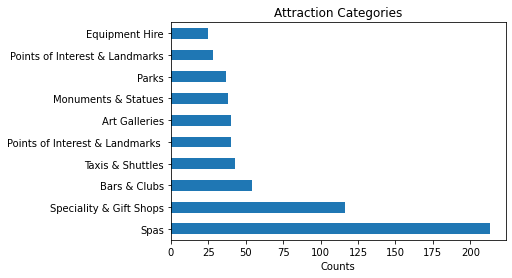

In [534]:
# count how mant attractions are in each category
bar.plot(kind = 'barh', )
plt.title('Attraction Categories');
plt.xlabel('Counts')

<b>Surprising amount of spas listed in the pages of vancouver attractions ^^^ </b>

In [532]:
final_df.describe()

,rating,num_reviews,suggested_duration(hr)
count,768.000000,1039.000000,193.000000
mean,4.145182,146.115496,2.248705
std,0.817078,1231.479977,0.433386
min,1.000000,0.000000,2.000000
25%,3.500000,0.000000,2.000000
50%,4.500000,2.000000,2.000000
75%,5.000000,15.000000,2.000000
max,5.000000,29062.000000,3.000000


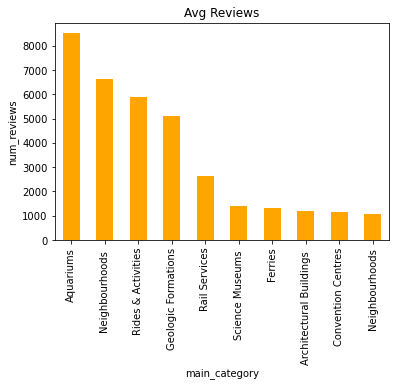

In [602]:
#finding the relationship between number of reviews and the categories
final_df.groupby('main_category')['num_reviews'].mean().sort_values(ascending = False).head(10).plot(kind = 'bar', color = 'orange')
plt.title('Avg Reviews')
plt.ylabel('num_reviews');

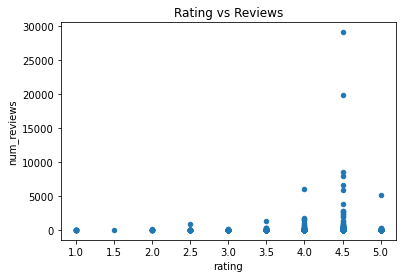

In [622]:
# seems like most of the ratings are in 4.5 and a good amount of people have reviewed it making the source believable
final_df.plot(x = 'rating', y = 'num_reviews', kind='scatter')
plt.title('Rating vs Reviews');